# TP1 - Vision par ordinateur

Importation des dépendances

In [169]:
import numpy as np
import cv2 as cv
import os
import matplotlib.pyplot as plt


from skimage.feature import graycomatrix, graycoprops
from skimage import io, color, img_as_float


## Data

Exemple

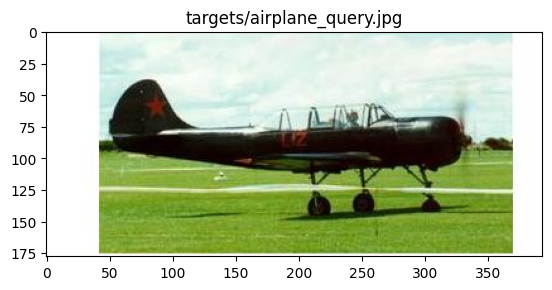

In [2]:
img_path = "data/targets/airplane_query.jpg"  
img = cv.imread(img_path)

image_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

# Utiliser matplotlib pour afficher l'image
plt.imshow(image_rgb)
plt.title(img_path[5:])
plt.show()

In [51]:
print(img.shape)

(178, 393, 3)


## Objectif 

Pour chaque image requête, trouver les images similaires de la base d'images 

## Mérthodologie 

A ) Pour les deux méthodes :

    -Caractériser chaque image 

    -Utiliser des métriques pour comparer les images caractérisées 

    -Mesurer le temps de calcul et la précision 

B ) Comparer les meilleurs résulats des deux méthodes selon différents cas

    - Région uniforme

    - Motifs locaux importants

    - Information de couleur

    - Texture directionnelle 

## MC

Méthode :

- Une matrice par image 
- N matrice de la même image ( variation de la distance et de l'orientation)
- Fenêtre glissante (plus matrice pour différentes parties de l'image)

Statistique extrait des matricdes de co-occurrence :

- contrast: Measures the local variations in the GLCM.

- homogeneity: Measures the closeness of the distribution of elements in the GLCM to the GLCM diagonal.

- correlation: Measures the joint probability occurrence of the specified pixel pairs.

- energy: Sum of squared elements in the GLCM. Also known as 'angular second moment'.

- dissimilarity: Measures the variation of grey level pairs in the GLCM.

### Fonction de match

Mesures de similarité

In [3]:
def compare_images_dist(reference_features, image_features):
    
    return np.linalg.norm(np.array(reference_features) - np.array(image_features))

Métrique d'évaluation

In [134]:
# Dossier contenant les images à comparer
data_path = 'data\\database'
targets_path = 'data\\targets'

def match(func): 
    
    t_match = 0
    f_match = 0
    
    images_features = []
    for filename in os.listdir(data_path):
        if filename.endswith(('.png', '.jpg', '.jpeg')):
            image_path = os.path.join(data_path, filename) 
            image_features = func(image_path)
            images_features.append((image_path, image_features))
        
    for q in os.listdir(targets_path) :
        target =os.path.join(targets_path, q)
        target_name = q.split("_query.jpg")[0]
        print(target_name)
        reference_features = func(target)

        similarities = []
        for path,image_features in images_features:
            similarity = compare_images_dist(reference_features, image_features)
            print("Compared")
            similarities.append((path, similarity))

        # Trier les images par similarité
        similarities.sort(key=lambda x: x[1])

        img_q = io.imread(target)
        plt.imshow(img_q)
        plt.title(f"target")
        # Afficher les 3 images les plus similaires
        
        plt.figure(figsize=(15, 5))
        print(similarities[:3])
        for i, (path, _) in enumerate(similarities[:3]):
            image_name =  path.split('\\')[-1]
            image_name = image_name.split("_")[0]

            if image_name == target_name :
                t_match += 1
            else :
                f_match += 1
            
            image = io.imread(path)
            plt.subplot(1, 3, i+1)
            plt.imshow(image)
            plt.title(f"Image {path[5:]}")
            plt.axis('off')

        plt.show()
        
    return t_match+f_match, t_match, f_match


### Une matrice par image

In [170]:
from skimage.color import rgb2gray

def calculate_1_glcm_features(image_path):
    """ Calcule les caractéristiques GLCM d'une image. """
    image = io.imread(image_path)
    image = img_as_float(image)  #Normalisation
    # Vérifiez si l'image est en couleur (3 canaux)
    if len(image.shape) == 3 and image.shape[2] == 3:
        gray_image = rgb2gray(image)
    else:
        gray_image = image  # l'image est déjà en niveaux de gris
    gray_image = (gray_image * 255).astype('uint8')

    glcm = graycomatrix(gray_image, distances=[1], angles=[0], levels=256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, prop='contrast')[0, 0]
    homogeneity = graycoprops(glcm, prop='homogeneity')[0, 0]
    correlation = graycoprops(glcm, prop='correlation')[0, 0]
    energy = graycoprops(glcm, prop='energy')[0, 0]
    dissimilarity = graycoprops(glcm, prop='dissimilarity')[0, 0]

    return contrast, homogeneity,correlation,energy,dissimilarity




### Test 1


airplane
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\face_3.jpg', 2.089300375345843), ('data\\database\\face_4.jpg', 3.9620778218040655), ('data\\database\\cat_3.jpg', 4.283163879782015)]


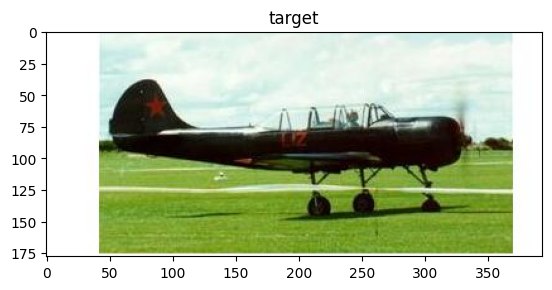

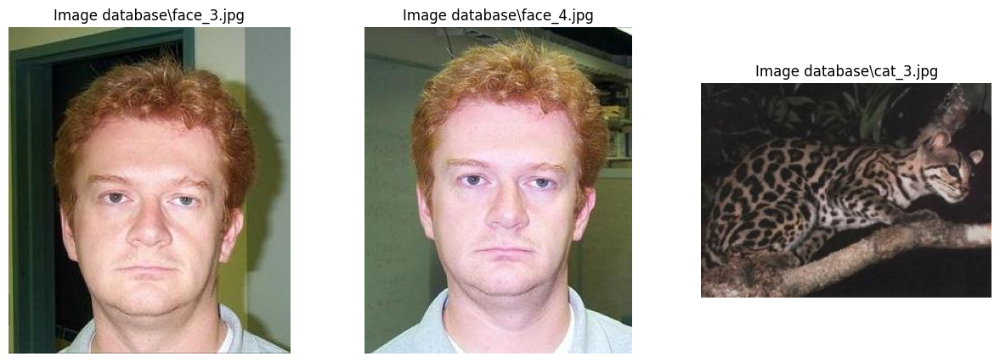

ball
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\ball_4.jpg', 10.070589508477305), ('data\\database\\lotus_1.jpg', 26.351569001537367), ('data\\database\\cat_2.jpg', 36.37044130986691)]


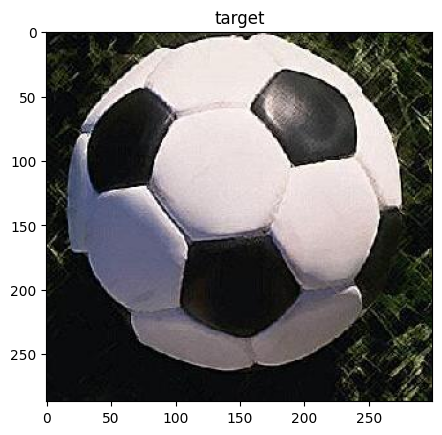

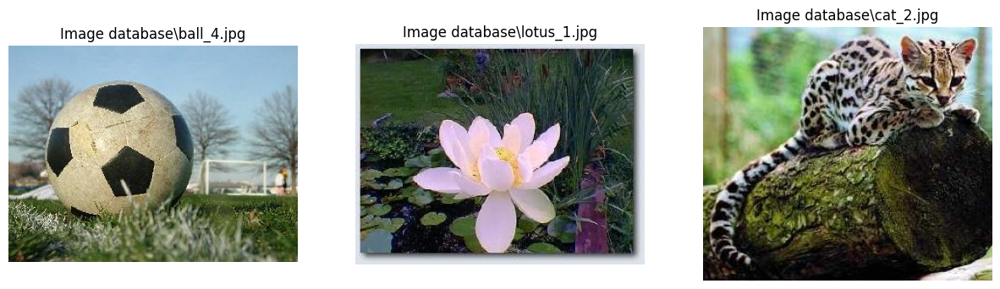

car
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\car_2.jpg', 2.9958249711806166), ('data\\database\\car_3.jpg', 10.239533434163269), ('data\\database\\dolphin_1.jpg', 10.32038703397876)]


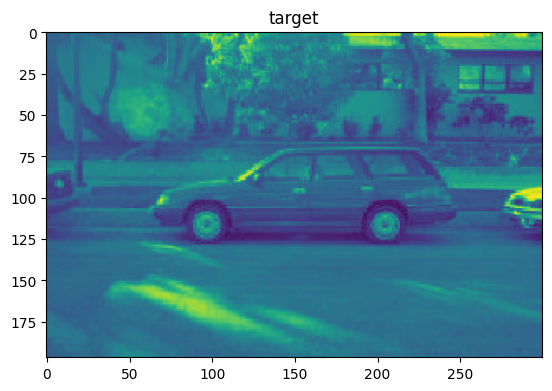

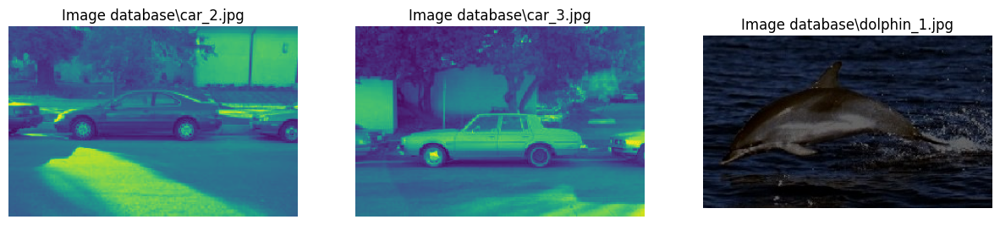

cat
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\lotus_1.jpg', 12.695039707799522), ('data\\database\\cat_2.jpg', 22.690236991960912), ('data\\database\\ball_4.jpg', 23.573911540982262)]


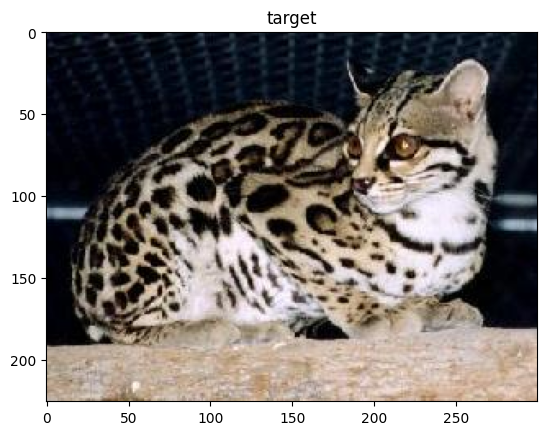

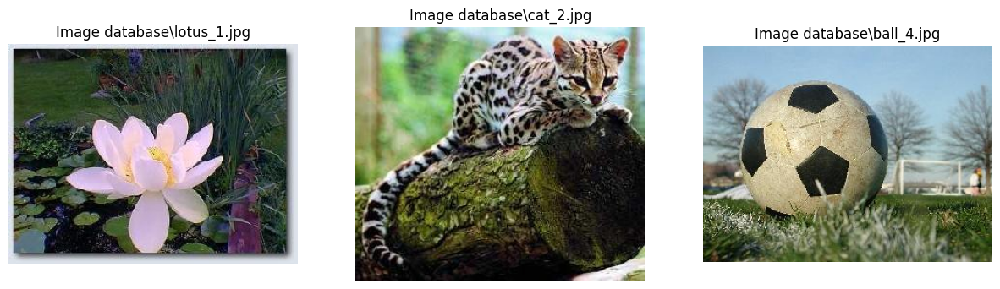

dolphin
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\car_3.jpg', 4.801330034169945), ('data\\database\\car_2.jpg', 12.062949817389578), ('data\\database\\face_2.jpg', 21.62113490025654)]


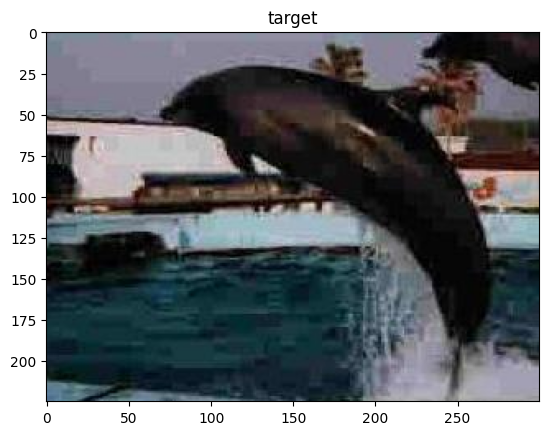

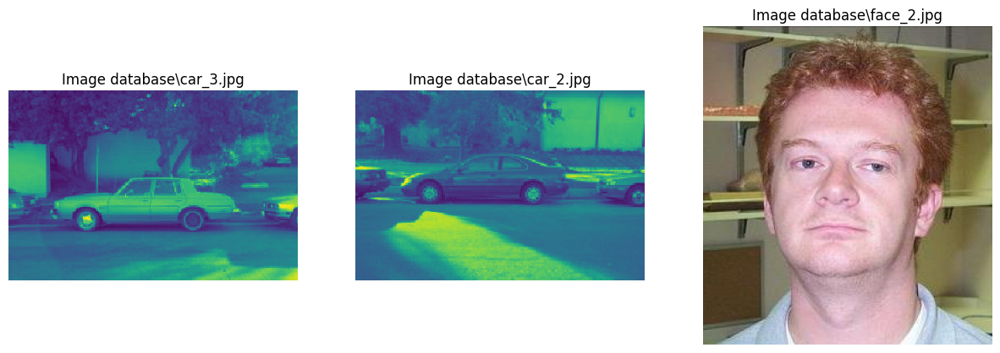

face
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\airplane_5.jpg', 8.848689856459606), ('data\\database\\airplane_2.jpg', 17.517255140686576), ('data\\database\\airplane_1.jpg', 20.531410059489083)]


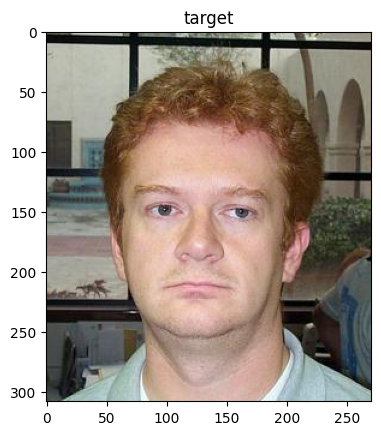

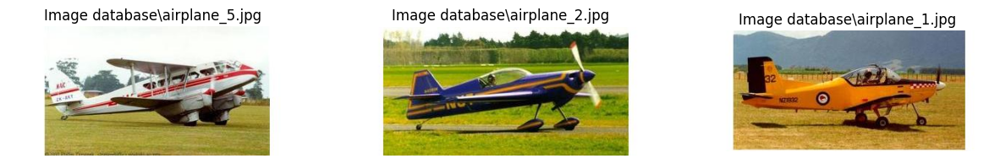

lotus
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\car_1.jpg', 1.1958069312648285), ('data\\database\\face_2.jpg', 2.664171040353146), ('data\\database\\airplane_4.jpg', 17.77542758234177)]


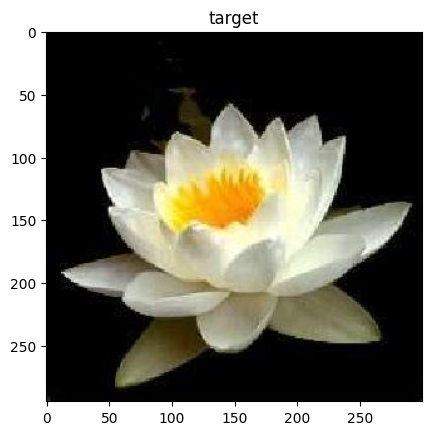

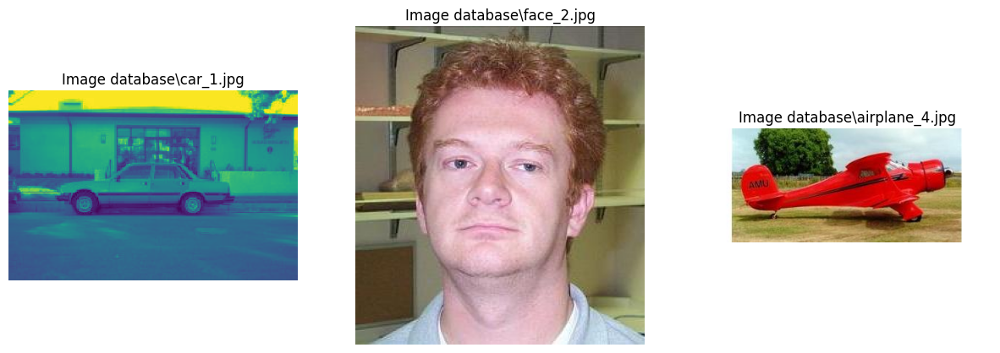

pickles_querry.jpg
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\pickles_2.jpg', 0.183123195996281), ('data\\database\\pickles_1.jpg', 1.834600914024132), ('data\\database\\dolphin_2.jpg', 12.766099878999295)]


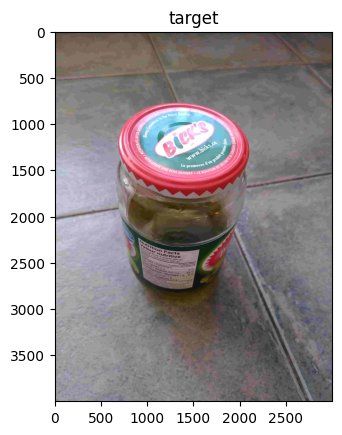

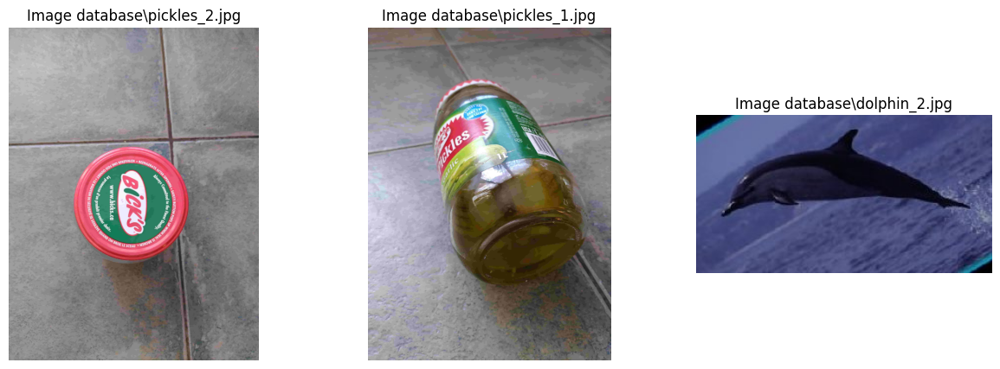

strawberry
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_5.jpg', 13.618192944248673), ('data\\database\\dolphin_5.jpg', 15.544823466641283), ('data\\database\\car_5.jpg', 17.841648095528114)]


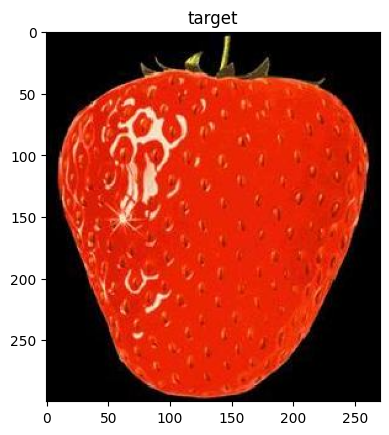

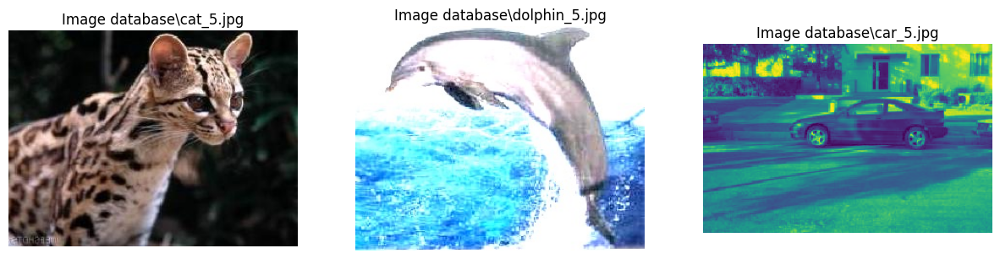

In [171]:
tot,t,f = match(calculate_1_glcm_features)

In [172]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 4
Précision = 0.14814814814814814


### Plusieurs Matrices Co-occurrence

In [125]:
def compute_features(image,distances,angles):
    features = []
    for distance in distances:
        for angle in angles:
            glcm = graycomatrix(image, distances=[distance], angles=[angle], levels=256, symmetric=True, normed=True)
            features.append(graycoprops(glcm, prop='contrast')[0, 0])
            features.append(graycoprops(glcm, prop='homogeneity')[0, 0])
            features.append(graycoprops(glcm, prop='correlation')[0, 0])
            features.append(graycoprops(glcm, prop='energy')[0, 0])
            features.append(graycoprops(glcm, prop='dissimilarity')[0, 0])
    return features

In [165]:

def calculate_glcm_features(image_path):
    """ Calcule les caractéristiques GLCM d'une image pour différentes distances et angles. """
    image = io.imread(image_path)
    image = img_as_float(image)  #Normalisation
    if len(image.shape) == 3 and image.shape[2] == 3:
        gray_image = color.rgb2gray(image)
    else:
        gray_image = image
    gray_image = (gray_image * 255).astype('uint8')

    distances = [1, 2]  # de 1, 2, 3 pixels
    angles = [0, np.pi/4]
    #angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]  #  angles 0, 45, 90 et 135 degrés

    features = compute_features(gray_image,distances,angles)

    return features




### Test 2

airplane
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\airplane_1.jpg', 99.03470916292983), ('data\\database\\airplane_3.jpg', 145.80754668319756), ('data\\database\\airplane_4.jpg', 152.37608202750573)]


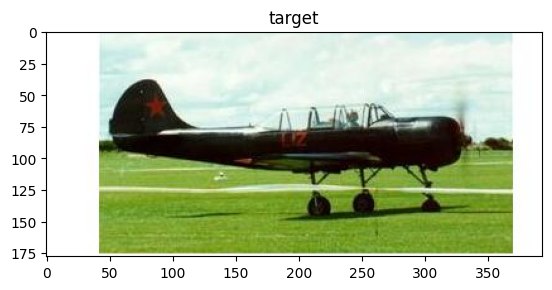

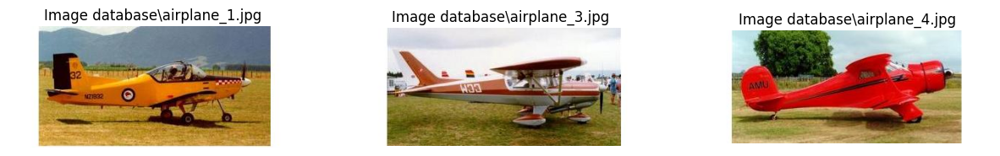

ball
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\lotus_1.jpg', 245.71034390433763), ('data\\database\\ball_4.jpg', 307.59092128234397), ('data\\database\\ball_1.jpg', 363.74324883529187)]


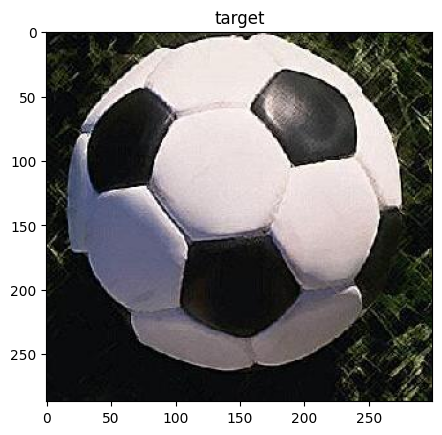

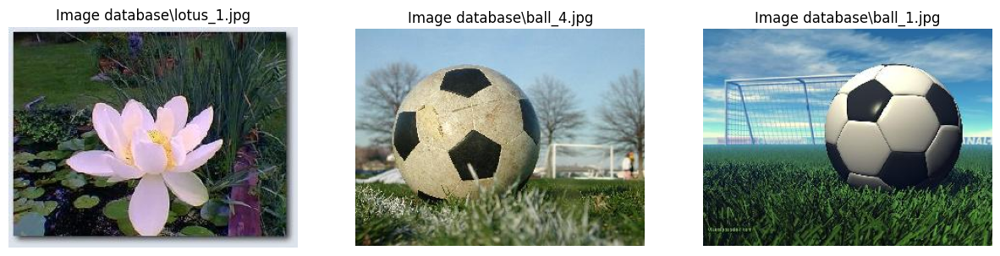

car
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\car_3.jpg', 23.697744124427683), ('data\\database\\car_2.jpg', 30.562442433016667), ('data\\database\\dolphin_1.jpg', 77.19716639812974)]


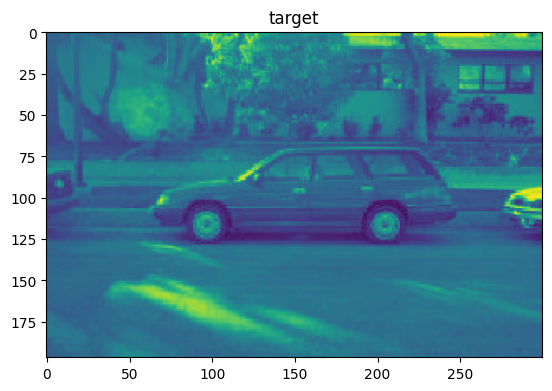

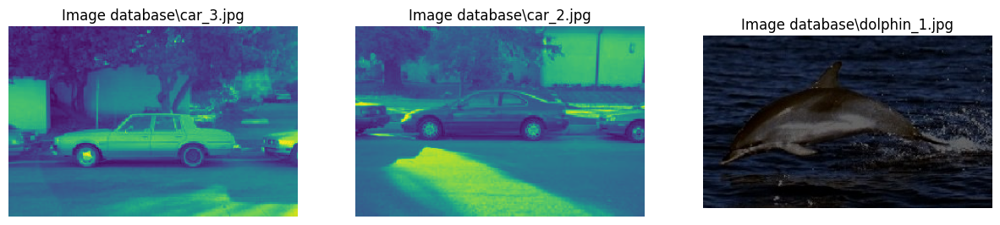

cat
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_2.jpg', 82.83437745210718), ('data\\database\\ball_5.jpg', 351.2268848504979), ('data\\database\\lotus_1.jpg', 405.6172895769996)]


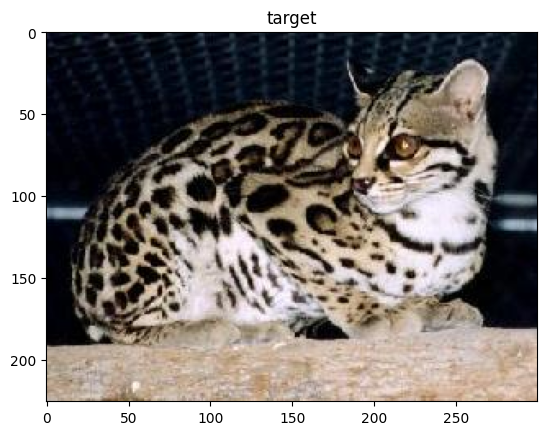

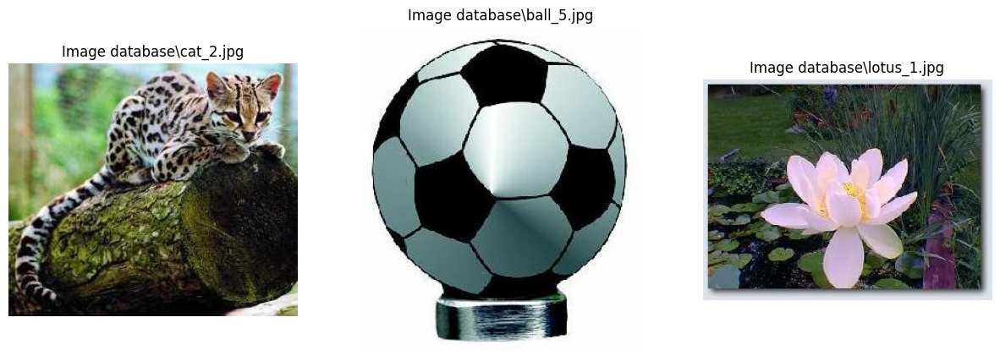

dolphin
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\face_2.jpg', 52.65506879715377), ('data\\database\\car_1.jpg', 84.14673858444995), ('data\\database\\airplane_4.jpg', 86.17035119891898)]


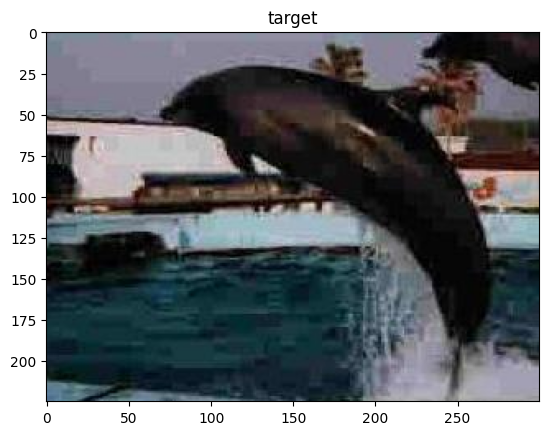

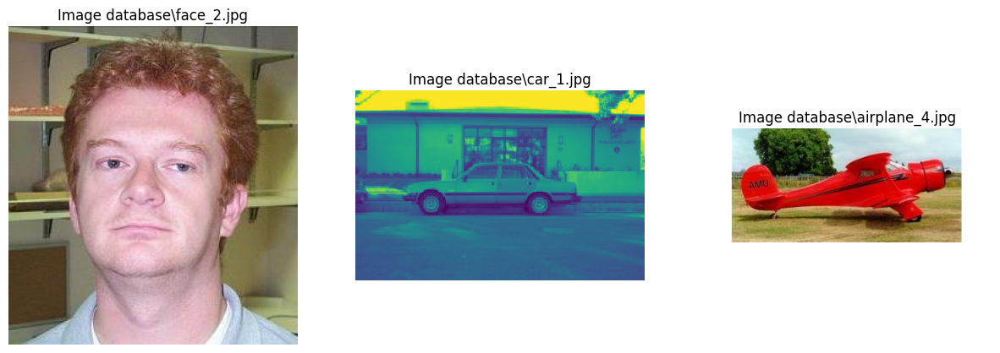

face
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\airplane_1.jpg', 68.04860329091838), ('data\\database\\ball_3.jpg', 92.38657695785163), ('data\\database\\airplane_4.jpg', 132.5187050299828)]


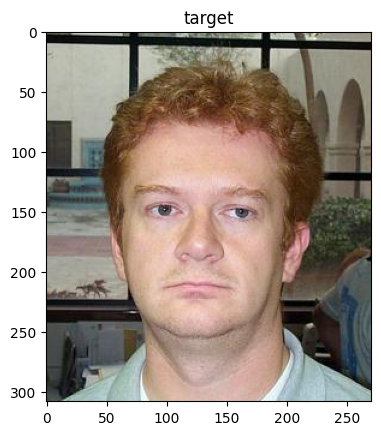

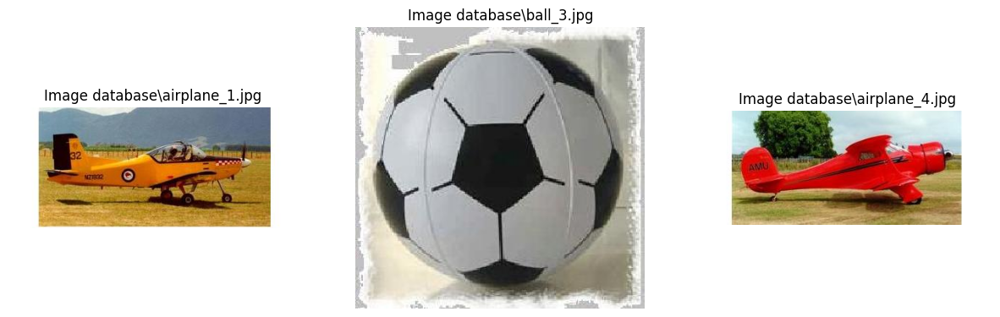

lotus
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\face_4.jpg', 26.54682459762278), ('data\\database\\face_3.jpg', 42.24241734645818), ('data\\database\\face_2.jpg', 44.373295262473164)]


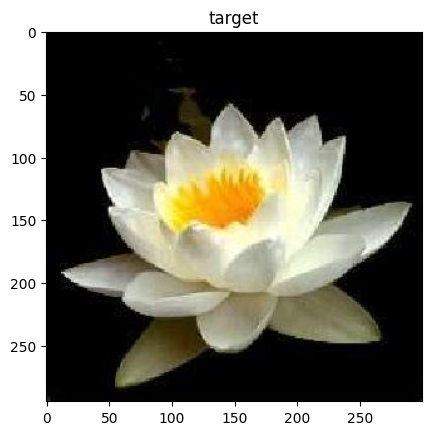

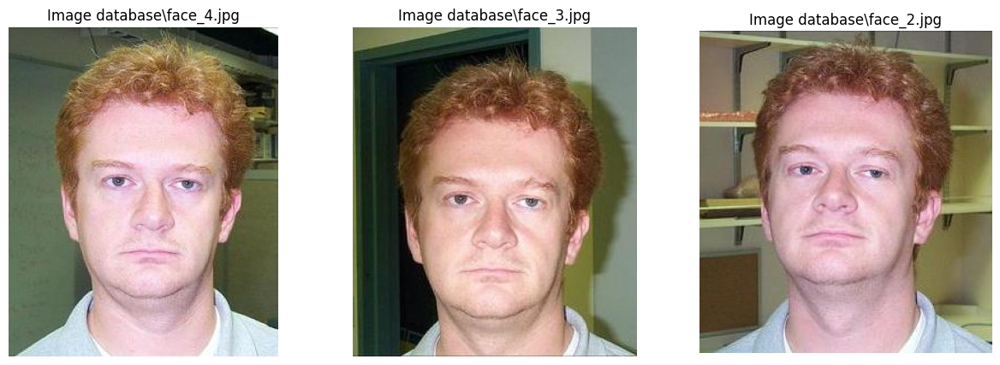

pickles_querry.jpg
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\pickles_2.jpg', 0.46794483007607146), ('data\\database\\pickles_1.jpg', 6.232431803484737), ('data\\database\\pickles_3.jpg', 72.62626611700847)]


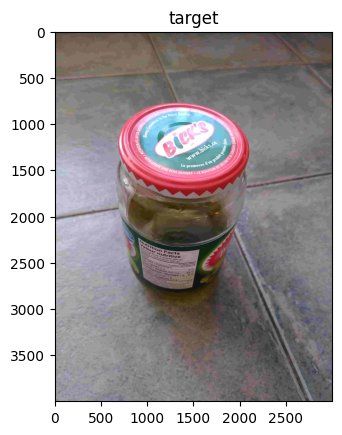

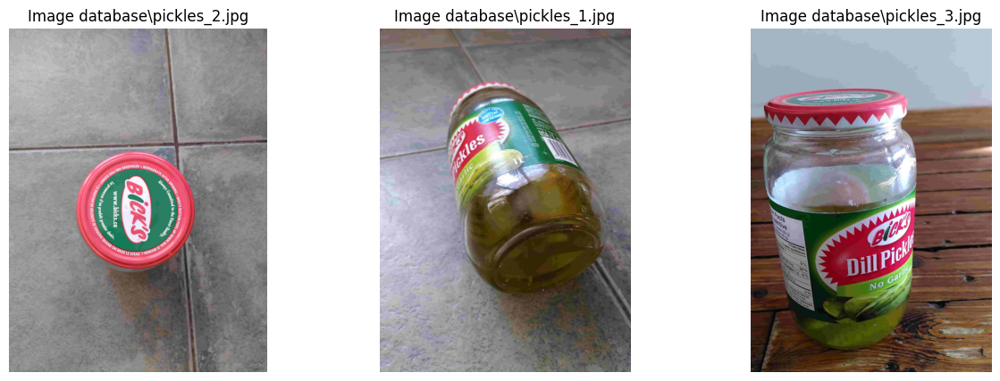

strawberry
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\ball_3.jpg', 125.2086719703317), ('data\\database\\airplane_1.jpg', 162.4516141749253), ('data\\database\\dolphin_5.jpg', 168.10531485153635)]


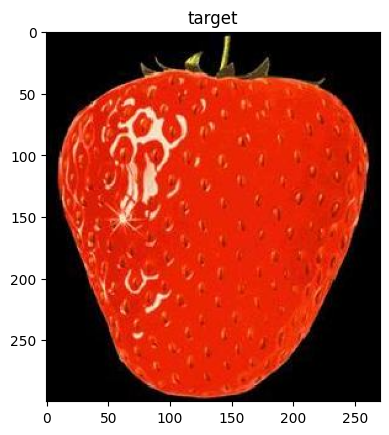

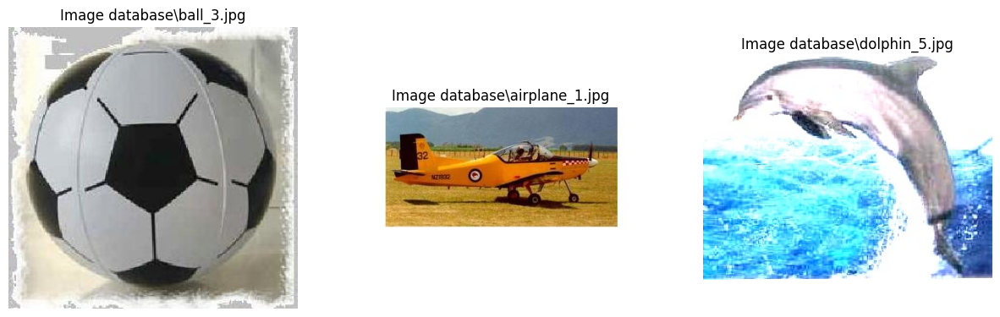

In [166]:
tot,t,f = match(calculate_glcm_features)

In [167]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 8
Précision = 0.2962962962962963


Lorsqu'on augmente les distances des pixels on obtient de moins bons résulats, les raisons potentielles : perte de Détails Locaux, davantage de bruit, diminution de la corrélation spatiale.

avec [1,2,36,8] -> p = 0.15

avec [1,2] -> p = 0.259

Pour les angles, les meilleurs résulats sont obtenus pour 0° et 45°, les raisons potentielles : les angles atypiques tels que 60° et 120° peuvent capturer plus de bruit avec des images de mauvaises qualités, l'ajout d'angles peuvent ajouter des informations redondantes.

avec [0°, 45°] -> p = 0.259

avec [0°, 45°, 90°, 135°] -> p=0.259

avec [0°, 45°,60°, 90°, 120°, 135°] -> p= 0.20

### Fenêtre glissante 

In [156]:


def calculate_windows_glcm_features(image_path):
    print(image_path)
    image = io.imread(image_path)
    if len(image.shape) == 3 and image.shape[2] == 3:
        gray_image = color.rgb2gray(image)
    else:
        gray_image = image
    gray_image = (gray_image * 255).astype('uint8')

    distances = [1, 2]  # de 1, 2, 3 pixels
    angles = [0, np.pi/4]
    
    #Paramètres window
    height, width = gray_image.shape
    window_size = max(height, width) // 20  # 10% de la plus grande dimension
    stride = window_size // 2  #  50% de la taille de la fenêtre
    features_all_windows = []
    
    
    for y in range(0, height - window_size + 1, stride):  # stride est le pas de la fenêtre
        for x in range(0, width - window_size + 1, stride):
            
            window = gray_image[y:y+window_size, x:x+window_size]
            features = compute_features(window,distances,angles)
            
            features_all_windows.append(features)
    print("FINISh--------------")       
    final_features = np.mean(features_all_windows, axis=0)

    return final_features




### Test 3

data\database\airplane_1.jpg
FINISh--------------
data\database\airplane_2.jpg
FINISh--------------
data\database\airplane_3.jpg
FINISh--------------
data\database\airplane_4.jpg
FINISh--------------
data\database\airplane_5.jpg
FINISh--------------
data\database\ball_1.jpg
FINISh--------------
data\database\ball_2.jpg
FINISh--------------
data\database\ball_3.jpg
FINISh--------------
data\database\ball_4.jpg
FINISh--------------
data\database\ball_5.jpg
FINISh--------------
data\database\car_1.jpg
FINISh--------------
data\database\car_2.jpg
FINISh--------------
data\database\car_3.jpg
FINISh--------------
data\database\car_4.jpg
FINISh--------------
data\database\car_5.jpg
FINISh--------------
data\database\cat_1.jpg
FINISh--------------
data\database\cat_2.jpg
FINISh--------------
data\database\cat_3.jpg
FINISh--------------
data\database\cat_4.jpg
FINISh--------------
data\database\cat_5.jpg
FINISh--------------
data\database\dolphin_1.jpg
FINISh--------------
data\database\dolphin

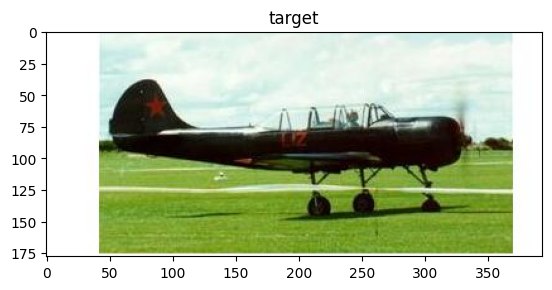

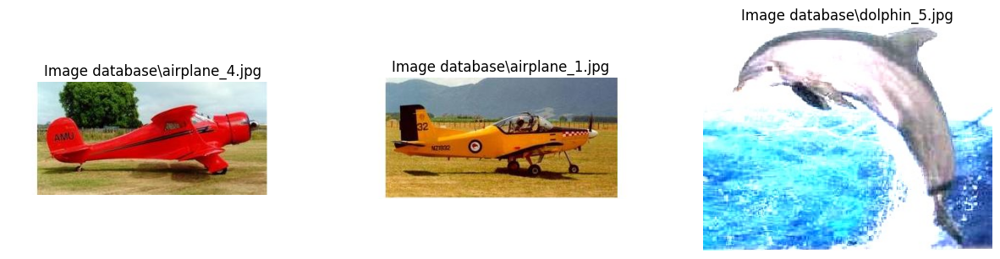

ball
data\targets\ball_query.jpg
FINISh--------------
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\lotus_1.jpg', 207.4679852049382), ('data\\database\\ball_4.jpg', 270.931023626614), ('data\\database\\cat_1.jpg', 302.6506007139983)]


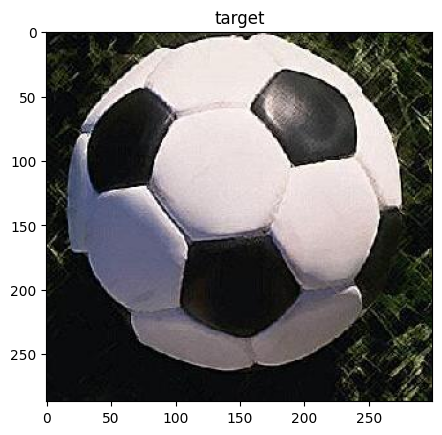

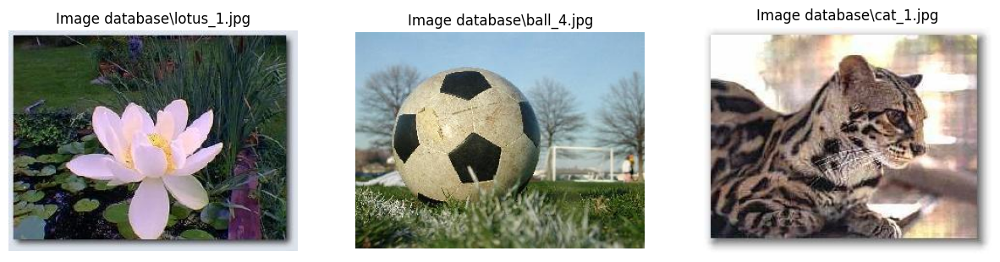

car
data\targets\car_query.jpg
FINISh--------------
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\car_3.jpg', 33.67219007020456), ('data\\database\\car_2.jpg', 35.952276815004126), ('data\\database\\dolphin_1.jpg', 66.25185135635681)]


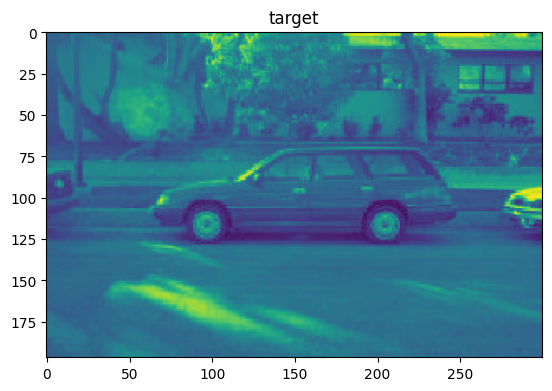

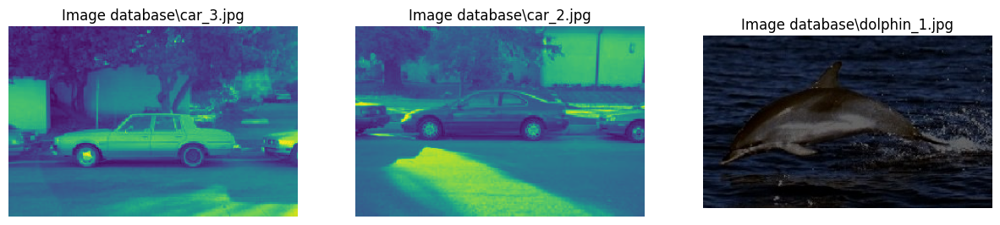

cat
data\targets\cat_query.jpg
FINISh--------------
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_2.jpg', 84.74463731059652), ('data\\database\\ball_5.jpg', 395.94615802279105), ('data\\database\\ball_1.jpg', 463.61888405945786)]


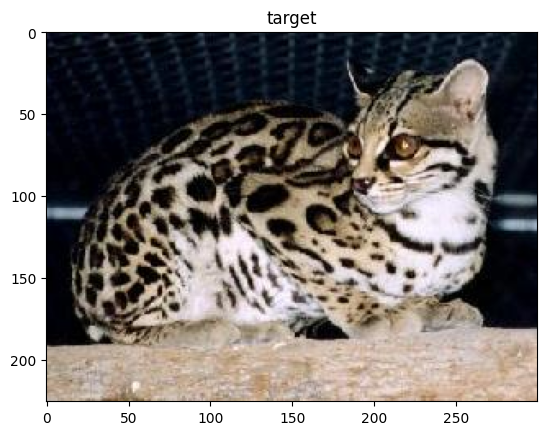

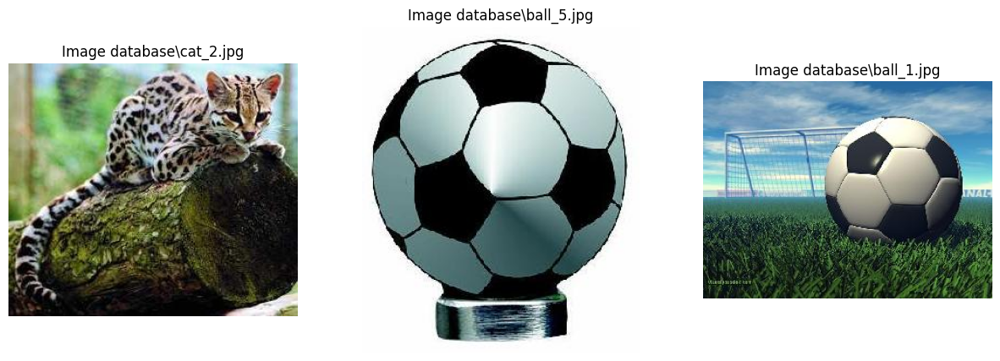

dolphin
data\targets\dolphin_query.jpg
FINISh--------------
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\face_2.jpg', 51.13653165420011), ('data\\database\\face_4.jpg', 95.81588514557497), ('data\\database\\car_1.jpg', 97.05895178855538)]


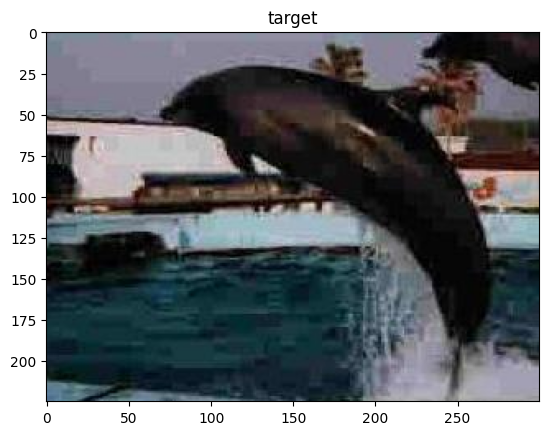

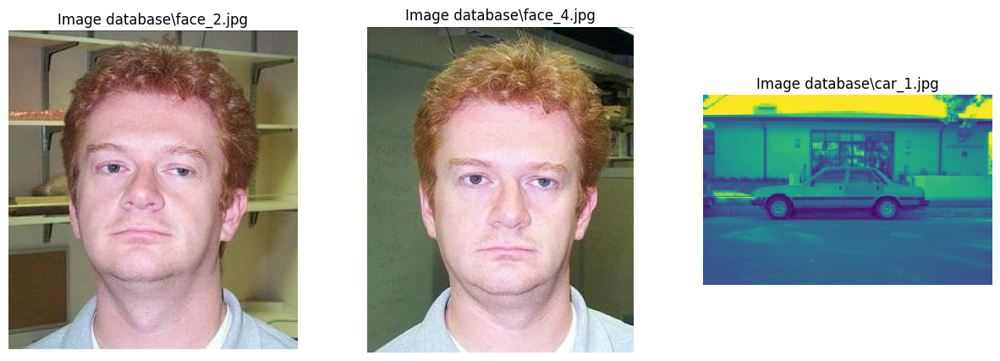

face
data\targets\face_query.jpg
FINISh--------------
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\lotus_2.jpg', 78.98817795945928), ('data\\database\\ball_3.jpg', 79.56844771911717), ('data\\database\\airplane_4.jpg', 85.78982840848508)]


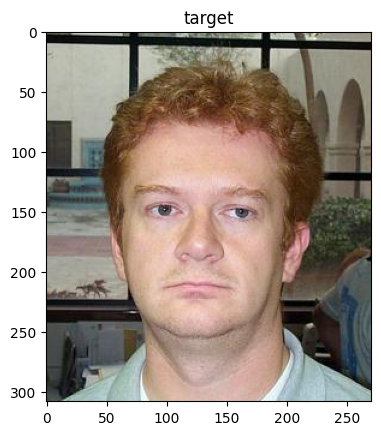

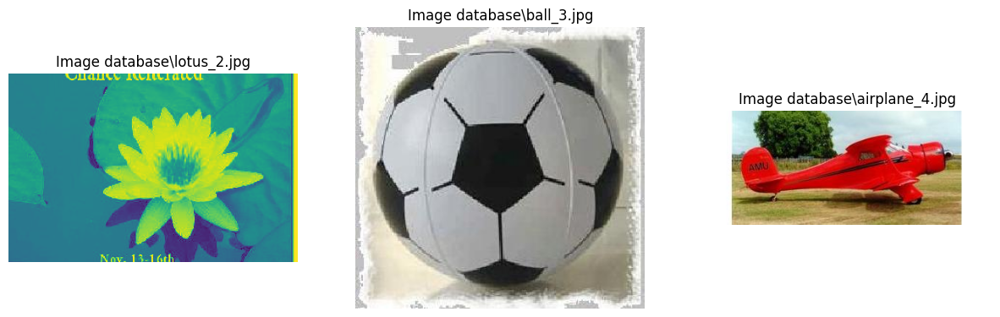

lotus
data\targets\lotus_query.jpg
FINISh--------------
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\face_4.jpg', 26.776484378115057), ('data\\database\\face_2.jpg', 39.419938593480666), ('data\\database\\face_3.jpg', 50.08391335407147)]


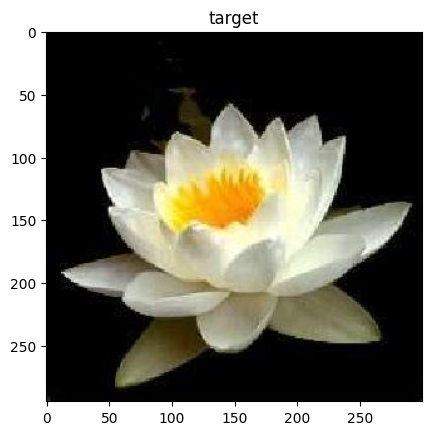

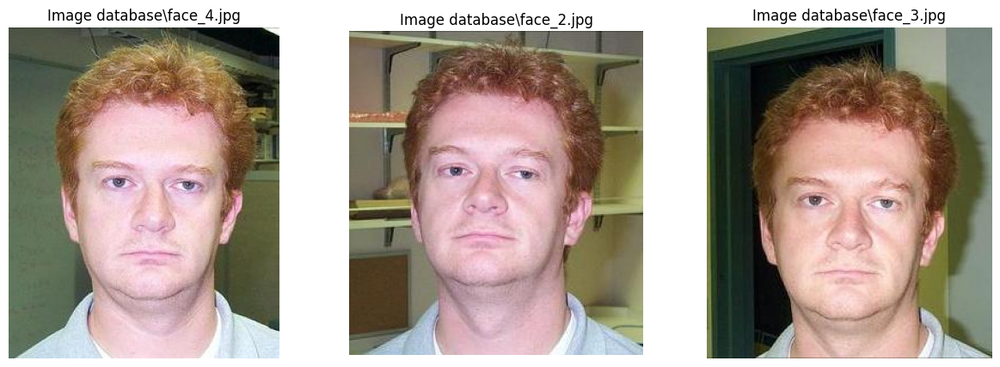

pickles_querry.jpg
data\targets\pickles_querry.jpg
FINISh--------------
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\pickles_2.jpg', 0.5429583572370839), ('data\\database\\pickles_1.jpg', 6.560149026404075), ('data\\database\\pickles_3.jpg', 76.89309261161316)]


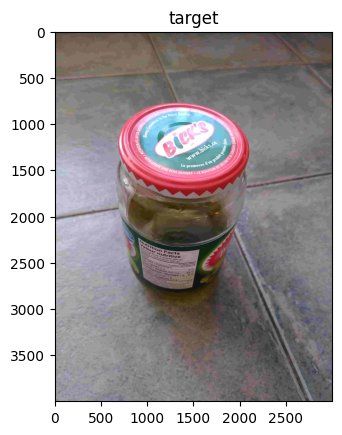

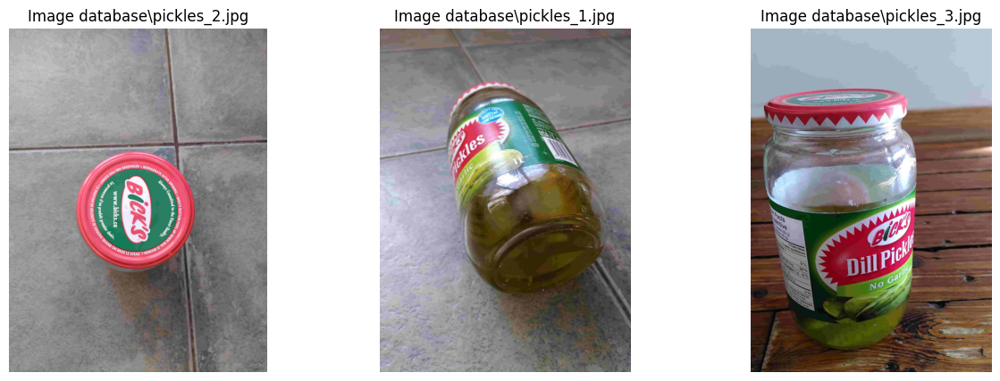

strawberry
data\targets\strawberry_query.jpg
FINISh--------------
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\face_5.jpg', 130.62695818648982), ('data\\database\\airplane_1.jpg', 146.26566841543087), ('data\\database\\face_1.jpg', 150.18931079679402)]


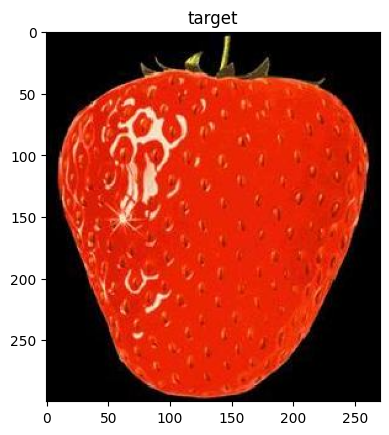

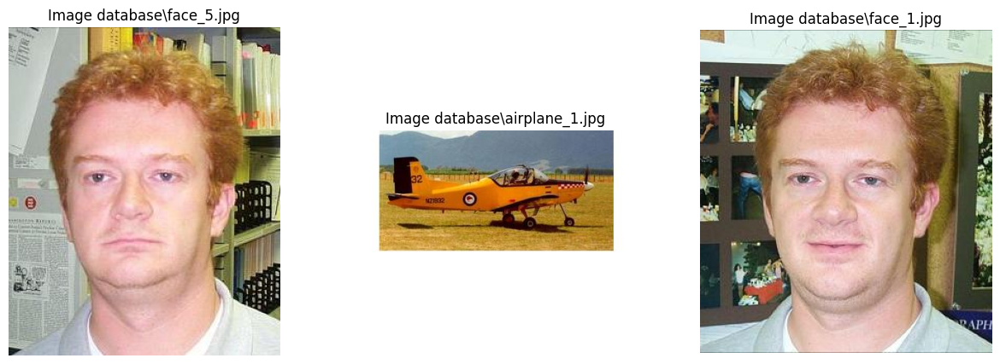

In [157]:
tot,t,f = match(calculate_windows_glcm_features)

In [158]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 6
Précision = 0.2222222222222222


### Prise en compte des canaux de couleurs

In [176]:

def compute_channel_features(channel, distances, angles):
    """ Calcule les caractéristiques GLCM pour un seul canal de couleur. """
    channel = (channel * 255).astype('uint8')
    features = []
    glcm = graycomatrix(channel, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)
    features.append(graycoprops(glcm, prop='contrast')[0, 0])
    features.append(graycoprops(glcm, prop='homogeneity')[0, 0])
    features.append(graycoprops(glcm, prop='correlation')[0, 0])
    features.append(graycoprops(glcm, prop='energy')[0, 0])
    features.append(graycoprops(glcm, prop='dissimilarity')[0, 0])
    return features

def calculate_channel_glcm_features(image_path):  
    """ Calcule les caractéristiques GLCM pour chaque canal de couleur d'une image. """
    image = io.imread(image_path)
    
    
    if len(image.shape) == 3 and image.shape[2] == 3:
        # Séparer les canaux de couleur
        red_channel, green_channel, blue_channel = image[:, :, 0], image[:, :, 1], image[:, :, 2]
    else:
        # Pour les images en niveaux de gris, traiter le canal unique
        red_channel = green_channel = blue_channel = image

    distances = [1, 2]
    angles = [0, np.pi/4]

    # Calculer les caractéristiques pour chaque canal
    features_red = compute_channel_features(red_channel, distances, angles)
    features_green = compute_channel_features(green_channel, distances, angles)
    features_blue = compute_channel_features(blue_channel, distances, angles)

    # Fusionner les caractéristiques de tous les canaux
    features = features_red + features_green + features_blue

    return features


airplane
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\airplane_3.jpg', 162.49476722575298), ('data\\database\\ball_4.jpg', 365.26169556479755), ('data\\database\\face_5.jpg', 369.02871960350564)]


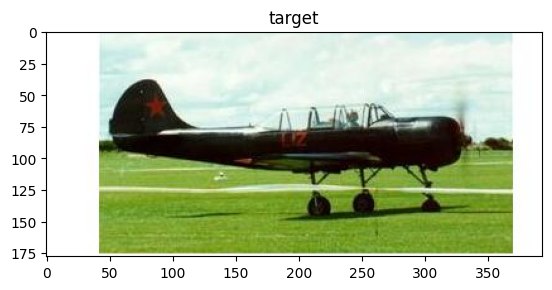

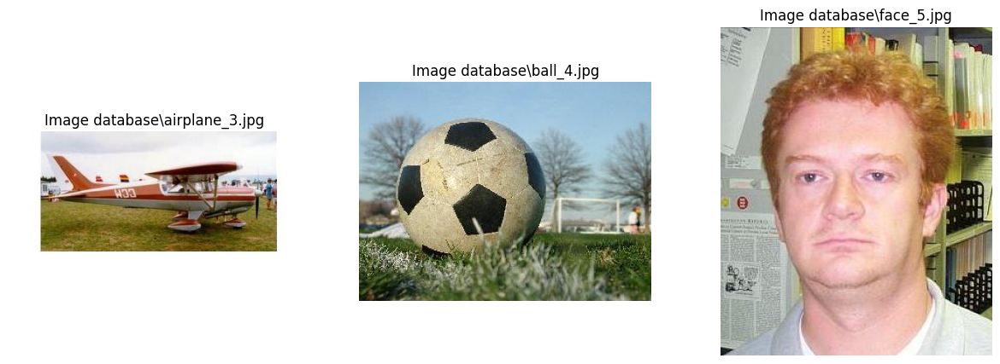

ball
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_2.jpg', 1062.9942497552602), ('data\\database\\ball_1.jpg', 1190.1210047984707), ('data\\database\\lotus_4.jpg', 1664.7671643351323)]


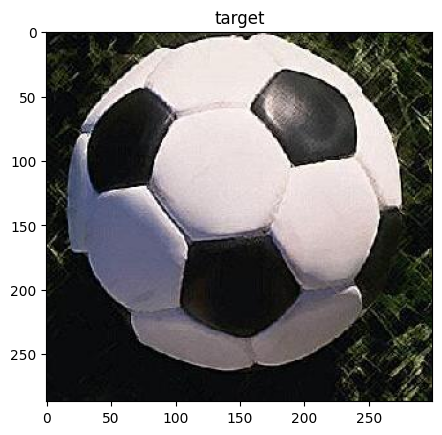

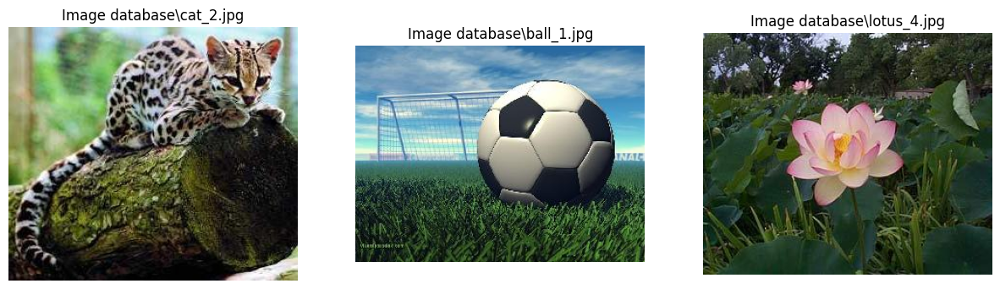

car
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\car_2.jpg', 5.083879916526207), ('data\\database\\car_3.jpg', 17.519570738011314), ('data\\database\\pickles_4.jpg', 39.35758969783388)]


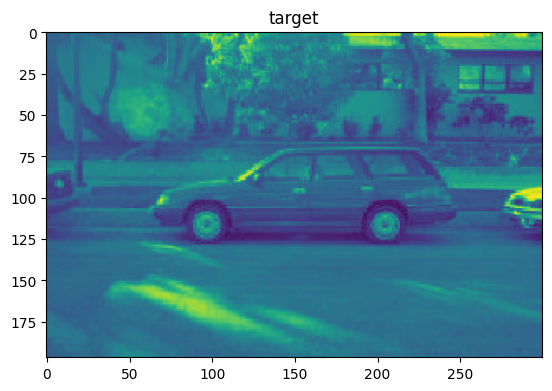

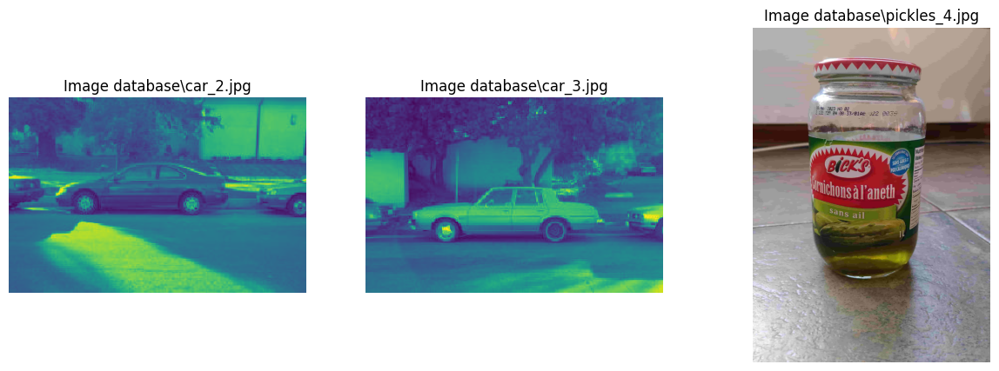

cat
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\ball_5.jpg', 1136.0013097320912), ('data\\database\\ball_1.jpg', 2497.548128639159), ('data\\database\\cat_4.jpg', 2774.2307313944093)]


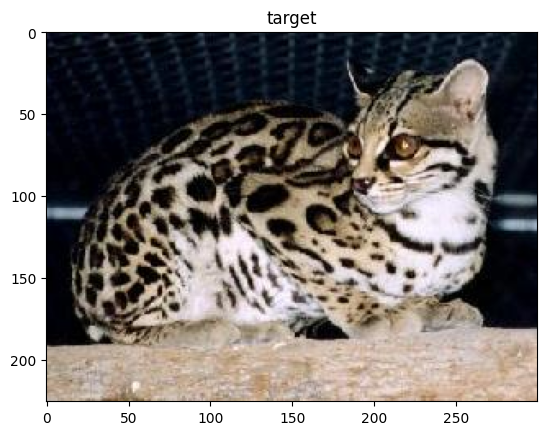

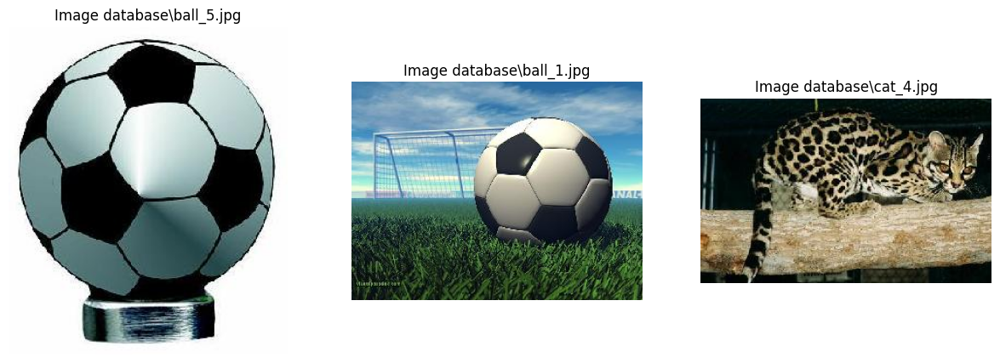

dolphin
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_5.jpg', 396.84039760499667), ('data\\database\\face_1.jpg', 401.9709369585705), ('data\\database\\cat_1.jpg', 414.4705840268469)]


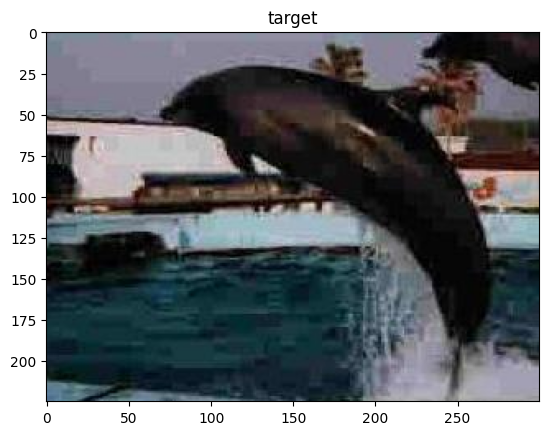

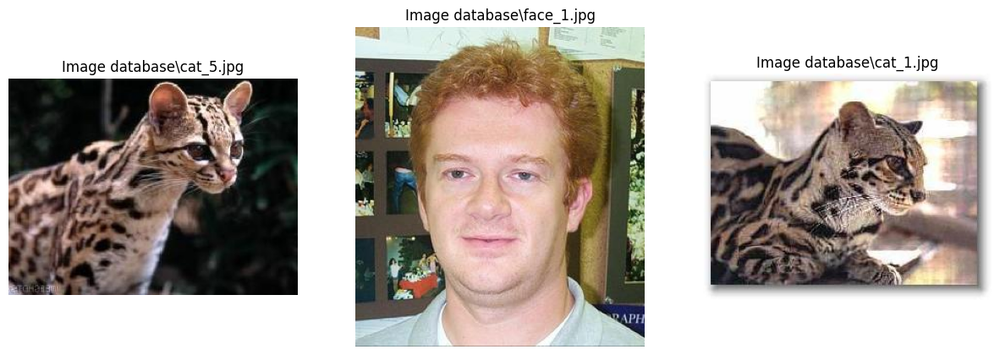

face
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\face_3.jpg', 62.03327315424418), ('data\\database\\car_4.jpg', 126.78746497941573), ('data\\database\\lotus_2.jpg', 136.39004152744965)]


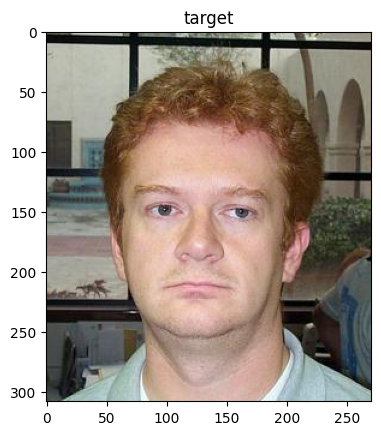

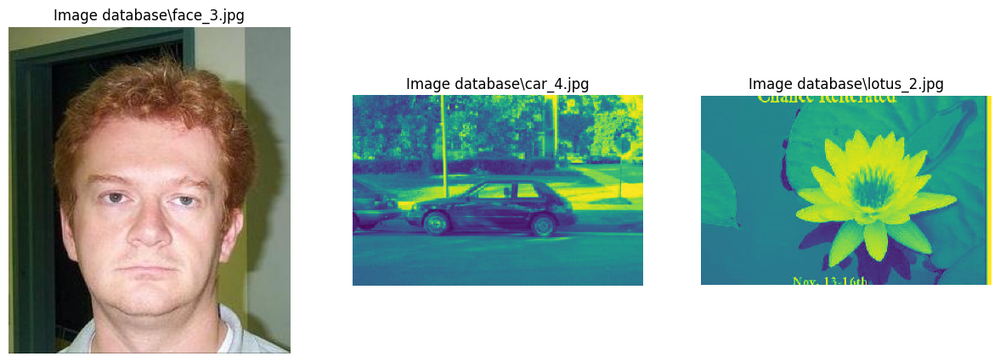

lotus
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\ball_5.jpg', 1291.3266235392541), ('data\\database\\ball_2.jpg', 1512.4512767496146), ('data\\database\\cat_2.jpg', 1565.5337070579935)]


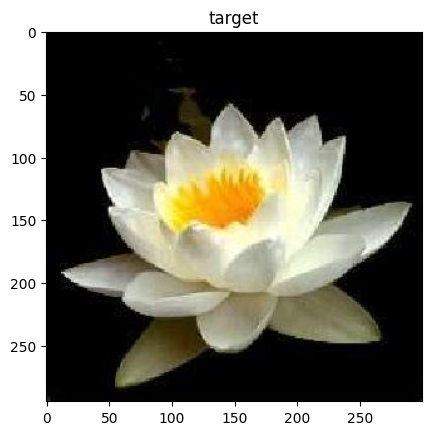

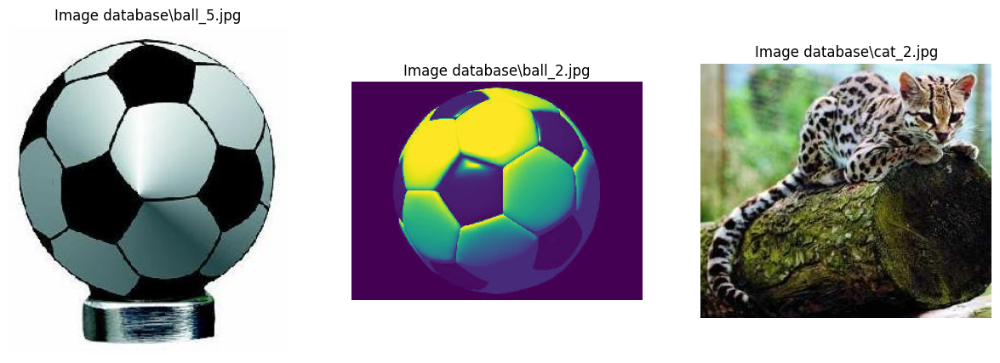

pickles_querry.jpg
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\pickles_2.jpg', 12.285979145139454), ('data\\database\\pickles_1.jpg', 26.730943464140573), ('data\\database\\car_2.jpg', 95.72004334507814)]


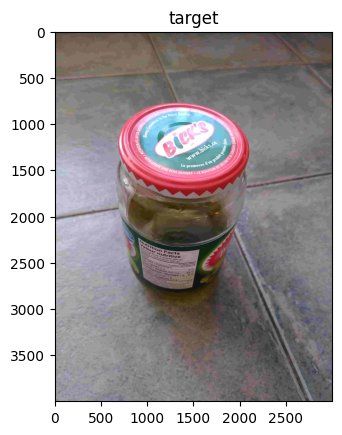

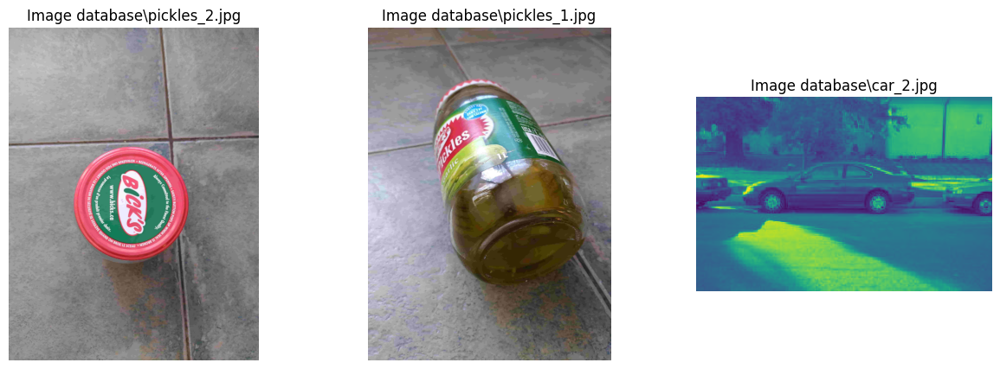

strawberry
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
Compared
[('data\\database\\cat_2.jpg', 4499.624364604136), ('data\\database\\airplane_2.jpg', 5177.75114099939), ('data\\database\\cat_4.jpg', 5516.150746374283)]


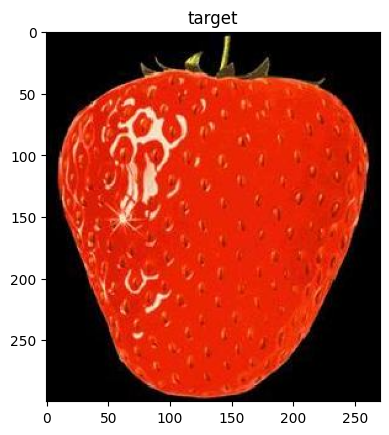

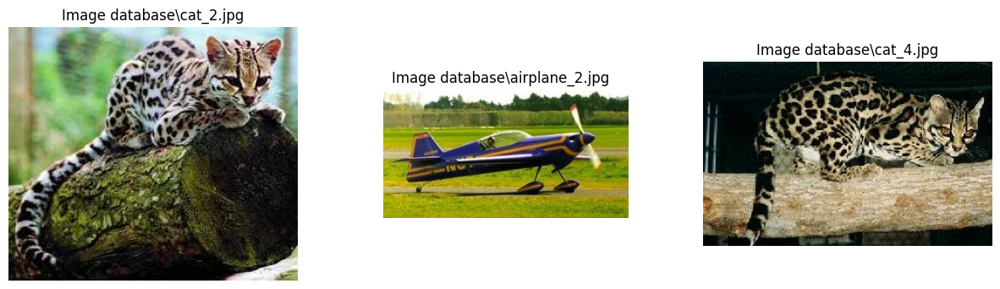

In [177]:
tot,t,f = match(calculate_channel_glcm_features)

In [178]:
precision = t/tot
print("Nombre de bons matchs = "+str(t))
print("Précision = " + str(precision))

Nombre de bons matchs = 6
Précision = 0.2222222222222222


On obtient de moins bonne performance qu'en travaillant sur les niveaux de gris

La normalisation n'aide pas lorsqu'on traite les couleurs